# RNN Supercointegrated Pairs Trading (Part 2)

This is the second component of a RNN pairs trading strategy. Part 1 demonstrated the methodology and theory behind obtaining a set of supercointegrated pairs from a large list of US equities on the S&P500. This article validates these pairs using stationarity tests on its realised voltatility, the Hurst Exponent value and the threshold of its mean-reversion half-life by modelling the timeseries spread against the [Ornstein-Uhlenbeck Process](https://en.wikipedia.org/wiki/Ornstein%E2%80%93Uhlenbeck_process). Once these validation tests are run, the RNN is trained on the data using an LSTM cell, predicting both single value and multiple values into the future to form the pre-optimised trading logic of the algorithm.

## Further indicators for the pairs

### Returns and risk

The following is a summary of the method provided by (Figuerola-Ferretti et al. 2017). The log returns performance measure proposed in (Ingersoll et al. 2007) are given by,

$$
    R_{PMG} = \frac{1}{(1 - \gamma) \Delta t} \ln \Big( \frac{1}{T} \sum_{i=1}^{T} \big( \frac{1 + r_t}{1 + r_{f,t}} \big)^{1 - \gamma} \Big),
$$

which is what we shall be using to study pairs' performance. The portfolio returns are given as $r_t$, risk-free asset returns as $r_{f,t}$, $T$ is the length of the return series, and $\gamma$ is the risk aversion coefficient. We shall also divide our supercointegrated pairs from the first part of this article into quintiles, with Q1 being the set of pairs with the highest trace statistic and Q5 contianin the lowest trace statistics. This is the inversion of the method used in <cite data-cite="6461367/2MSLFVXU"></cite> as they use p-values as their cointegration level measure. Splitting the pairs into quintiles allows for the formation of five tranched portfolios, for the comparison of risk-return relationships between tranches which vary by cointegration strength. The following form our comparison measures between trading models.

1. Annual return
2. Cumulative return
3. Max drawdown
4. $R_{PMG}$
5. Sharpe Ratio (return vs. risk)
6. Calmar ratio (annualised compounded rate of return vs. maximum drawndown risk)

The time dependent risk-return relationship $RV_{i,t}$ of the portfolio over the last 21 trading observations of daily returns is used to evaluate the persistence of the portfolio and realised market. The Q1 portfolio and S&P 100 portfolio is indicated by $i$ and $r_{i,t-j}$ is the daily returns of each strategy within the portfolio.

$$
    RV_{i,t} = \sqrt{\sum_{j=0}^{20}r^2_{i,t-j}}
$$

This value acts as a realised volatility measure for time $t$ with constant $c$, autoregression coefficient $\phi$, and normally distributed error term $\varepsilon_t$ in forming autoregression model of degree 1 $AR(1)$ below.

$$
    RV_{i,t} = c + \phi RV_{i,t-1} + \varepsilon_t
$$

### Supercointegrated Quintiles

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
import numpy as np
import pandas as pd
import plotly.figure_factory as ff
import plotly.graph_objects as go
from scripts.iex_timeseries import symbols, load_test_data
import statsmodels.api as sm
import statsmodels.tsa.stattools as ts

sc_df = pd.read_pickle('data/supercointegrated_df.pickle')

sc_df.sort_values(by=['traceStat'], inplace=True, ascending=False)
sc_df.index = range(len(sc_df))

# Create quintiles using pandas.qcut()
sc_df['Quintile'] = pd.qcut(sc_df.traceStat, 5, duplicates='drop', labels=[5-i for i in range(5)])

def df_to_table(df):
    table = ff.create_table(df)
    return go.FigureWidget(table)

df_to_table(sc_df[['Pair', 'traceStat', 'Quintile']])

FigureWidget({
    'data': [{'colorscale': [[0, '#00083e'], [0.5, '#ededee'], [1, '#ffffff']],
              '…

If we go to our first pair as an example and take the spread returns (first difference of the spread). 

In [3]:
pair = sc_df.Pair.iloc[0]

test_data = load_test_data(100)
symbol_list = symbols(100)

def load_full_dataset():
    n_symbols = 100
    fund_type = str(n_symbols)
    symbol_list = symbols(fund_type)
    return load_test_data(fund_type)

def interesting_symbols():
    interesting_symbols = []
    for pair in df.Pair.to_list():
        for symbol in pair:
            if not symbol in symbols(symbol_list):
                interesting_symbols.append(symbol)
    return interesting_symbols.sort()

def hedge_ratio(Y, X):
    X = sm.add_constant(X)
    model = sm.OLS(Y, X).fit()
    return model.params[1]
    

def spread(Y, X):
    hedge = hedge_ratio(Y, X)
    return Y - hedge * X
    
    
class PairOperation: 
    def __init__(self, pair):
        data = load_test_data(100)
        self.value = pair
        self.symbol1, self.symbol2 = [data[symbol] for symbol in self.value]
        self.hedge_ratio = hedge_ratio(self.symbol1.close, self.symbol2.close)
        df = pd.DataFrame(index=self.symbol1.index)
        for num, symbol in enumerate([self.symbol1, self.symbol2]):
            for name, column in symbol.iteritems():
                df[name + str(num)] = column
        df['Spread'] = spread(self.symbol1.close, self.symbol2.close)
        df['Return'] = df.Spread.diff()
        self.df = df.round({'Spread': 4, 'Return': 4})

        
    def RV(self, forecast_window):
        return_squared = self.df.Return.pow(2)
        return return_squared.rolling(forecast_window).sum().pow(0.5)
    

def create_traces(df, underlying, window):
    rolling = df[underlying].rolling(window)
    df['RollingMean'] = rolling.mean()
    df['Sigma_w'] = rolling.std()
    df['Upper'] = df.RollingMean + 2 * df.Sigma_w 
    df['Lower'] = df.RollingMean - 2 * df.Sigma_w 
    return df
    
    
def pair_plot(obj, underlying='Spread', window=182):
    # underlying can be 'spread' or 'pair_returns' 
    
    df = create_traces(obj.df, underlying, window)
    trace_names = [underlying, 'Upper', 'RollingMean', 'Lower']
    
    fig = go.Figure()
    for trace in trace_names:
        fig.add_trace(go.Scatter(x=df.index,
                                 y=df[trace],
                                 name=trace))
    
    title = underlying + ' for {} - {} (Drag slider to compress range)'.format(*obj.value)
    
    valid_df = df.dropna()
    valid_timestamps = valid_df.index.to_list()
    entry_limits = [valid_timestamps[0], valid_timestamps[-1]]
    
    fig.update_layout(
        title_text=title,
        xaxis_range=entry_limits,
        xaxis_rangeslider_visible=True)
    
    return go.FigureWidget(fig)

pair_obj_sample = PairOperation(pair) 

In [4]:
pair_to_str = lambda pair: pair[0]+'+'+pair[1] 
pairs_as_strs = [pair[0]+'+'+pair[1] for pair in sc_df.Pair.to_list()]

In [5]:
@interact
def plot_pair(PlotType=['Spread', 'Return'], Pair=pairs_as_strs, RollingWindow=(7, 700, 7)):
    pair_as_tuple = tuple(symbol for symbol in Pair.split('+'))
    pair_obj = PairOperation(pair_as_tuple)
    return pair_plot(pair_obj, PlotType, RollingWindow)

interactive(children=(Dropdown(description='PlotType', options=('Spread', 'Return'), value='Spread'), Dropdown…

In [6]:
pairs = sc_df.loc[sc_df.Quintile == 1, 'Pair'].to_list()
timestamps = pair_obj_sample.df.index
spread_df, returns_df, rv_df = [pd.DataFrame(index=timestamps) for i in range(3)]
for pair in pairs:
    symbol1, symbol2 = pair
    label = symbol1 + '+' + symbol2
    pair_operation = PairOperation(pair)
    df = pair_operation.df
    spread_df[label] = df.Spread
    returns_df[label] = df.Return
    rv_df[label] = pair_operation.RV(21)
pair_dfs = [spread_df, returns_df, rv_df]

In [7]:
def plot_rv(pair, take_difference):
    # underlying can be 'spread' or 'pair_returns'  
    fig = go.Figure()
    Y = rv_df[pair]
    if take_difference:
        Y = Y.diff()
    
    fig.add_trace(go.Scatter(x=rv_df.index,
                             y=Y))
    
    title = 'Risk-return time-dependent ratio (Drag slider to compress range)'
    valid_df = Y.dropna()
    valid_timestamps = valid_df.index.to_list()
    entry_limits = [valid_timestamps[0], valid_timestamps[-1]]
    
    fig.update_layout(
        title_text=title,
        xaxis_range=entry_limits,
        xaxis_rangeslider_visible=True)
    
    return go.FigureWidget(fig)

In [8]:
@interact
def display_df_based_on_attribute(Q1Pair=rv_df.columns, Reduce=[False, True]):
    return plot_rv(Q1Pair, Reduce)

interactive(children=(Dropdown(description='Q1Pair', options=('BKNG+UPS', 'UPS+USB', 'JNJ+UPS', 'GM+JNJ', 'GM+…

In [9]:
rv_df.dropna(inplace=True)

In [10]:
# As from https://www.machinelearningplus.com/time-series/vector-autoregression-examples-python/
def adfuller_test(series, signif=0.01, name='', verbose=False):
    """Perform ADFuller to test for Stationarity of given series and print report"""
    r = ts.adfuller(series, regression='ct', autolag='AIC')
    output = {'test_statistic':round(r[0], 4), 'pvalue':round(r[1], 4), 'n_lags':round(r[2], 4), 'n_obs':r[3]}
    p_value = output['pvalue'] 
    def adjust(val, length= 6): return str(val).ljust(length)

    # Print Summary
    print(f'    Augmented Dickey-Fuller Test on "{name}"', "\n   ", '-'*47)
    print(f' Null Hypothesis: Data has unit root. Non-Stationary.')
    print(f' Significance Level    = {signif}')
    print(f' Test Statistic        = {output["test_statistic"]}')
    print(f' No. Lags Chosen       = {output["n_lags"]}')

    for key,val in r[4].items():
        print(f' Critical value {adjust(key)} = {round(val, 3)}')

    if p_value <= signif:
        print(f" => P-Value = {p_value}. Rejecting Null Hypothesis.")
        print(f" => Series is Stationary.")
    else:
        print(f" => P-Value = {p_value}. Weak evidence to reject the Null Hypothesis.")
        print(f" => Series is Non-Stationary.")    
        
# ADF Test on each column
for name, column in rv_df.iteritems():
    adfuller_test(column, name=column.name)
    print('\n')

    Augmented Dickey-Fuller Test on "BKNG+UPS" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.01
 Test Statistic        = -4.4784
 No. Lags Chosen       = 0
 Critical value 1%     = -3.972
 Critical value 5%     = -3.417
 Critical value 10%    = -3.131
 => P-Value = 0.0016. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "UPS+USB" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.01
 Test Statistic        = -5.1494
 No. Lags Chosen       = 10
 Critical value 1%     = -3.972
 Critical value 5%     = -3.417
 Critical value 10%    = -3.131
 => P-Value = 0.0001. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "JNJ+UPS" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance

So apparently each of our RV series is in fact stationary. Now we test it against an AR(1) modewl so we can be confident in our secondary check on our supercointegrated pairs.

## Further timeseries tests

In [11]:
warnings.filterwarnings("ignore")

In [12]:
import statsmodels.tsa.ar_model as ar_mod 

def auto_regression(rv):
    model = ar_mod.AR(rv)
    fitted_model = model.fit()
    return fitted_model.params[0], fitted_model.params[1]

q1_df = sc_df.loc[sc_df.Quintile == 1]
q1_df['C'] = [auto_regression(rv)[0] for _, rv in rv_df.iteritems()]
q1_df['Phi'] = [auto_regression(rv)[1] for _, rv in rv_df.iteritems()]
pair_objs = [PairOperation(pair) for pair in q1_df.Pair]
q1_df['HedgeRatio'] = [obj.hedge_ratio for obj in pair_objs]
table = df_to_table(q1_df[['Pair','C','Phi','HedgeRatio']])
table

FigureWidget({
    'data': [{'colorscale': [[0, '#00083e'], [0.5, '#ededee'], [1, '#ffffff']],
              '…

### Hurst Exponent

Mean reversion is only considered for Hurst $H$ values between $0$ and $0.4$. The lookback looks back three months into the past and has a max lag amount of 31 days (1 month). We are interested in this statistic as an indication of how mean reverting the timeseries is, and how similar it is to a Geometric Brownian Motion (GBM, Random Walk). 

1. H = 0.5: GBM, varying over time
2. 0.5 < H < 1.0: Autocorrelation (positive or negative)
3. 0 < H < 0.5: Mean reverting - the more stationary the timeseries is. 

Judging by our ADF stationarity tests, we would expect Hurst values between 0 and 0.4 for our RV measure. 

In [13]:
class HurstExponent:
    
    def __init__(self):
        self.min, self.max = (0, 0.4)
        self.lookback, self.lagmax = (126, 63)
        self.value = None
        self.tau_func = lambda x, y: np.sqrt(np.std(np.subtract(x, y)))
    
    def run(self, timeseries):
        lags = range(2, self.lagmax)
        ts = timeseries.to_numpy()
        tau =  [self.tau_func(ts[lag:], ts[:-lag]) for lag in lags]
        poly = np.polyfit(np.log10(lags), np.log10(tau), 1)
        self.value = 2. * poly[0]
        return self.value 

In [14]:
h = HurstExponent()
h_rv = [h.run(rv) for _, rv in rv_df.iteritems()]
q1_df['H'] = h_rv
q1_df

,Pair,Eigenvectors,Eigenvalues,traceStat,Quintile,C,Phi,HedgeRatio,H
0,"(BKNG, UPS)","[[0.001041200311856087, -0.008027446794719879]...","[0.01936375114061773, 0.01605381126152]",11.555426,1,21.786184,0.948589,4.942992,0.266871
1,"(UPS, USB)","[[0.16702017107465747, 0.05328419230605639], [...","[0.02529486774696437, 0.015019566449027447]",10.805321,1,0.808370,1.070738,1.612865,0.302302
2,"(JNJ, UPS)","[[-0.031127135613919034, -0.1453866216653567],...","[0.017417514824940788, 0.014595789835319013]",10.498196,1,1.069036,0.996132,0.160485,0.360202
3,"(GM, JNJ)","[[-0.06327628797090235, -0.3378275526334503], ...","[0.015090724803419548, 0.011973592028760175]",8.600739,1,0.395896,0.996275,0.077776,0.338227
4,"(GM, UPS)","[[0.05816475014876756, -0.37360886782036173], ...","[0.01834610895575078, 0.01147992527174976]",8.244078,1,0.468793,0.972387,0.172623,0.325963
5,"(COF, GM)","[[-0.019320353323108788, -0.17129476764624177]...","[0.021247237831922644, 0.011373778386743829]",8.167413,1,0.872864,1.028103,0.869903,0.328282


This is ok, but a reassessment might be in order when tweaking this model. When running the Hurst Exponent method for lookbacks and lags of one month and ten days respectively results in H values centred around 0.5 - indicating Brownian motion. This is evolution over time and conflicts with the overall philosophy of pairs trading - that we are in a neutral market. 

### Half-life

In [15]:
class HalfLife:
    
    def __init__(self):
        self.min, self.max = (1.0, 25.0)
        self.lookback = 31
        self.value = None
        
    def run(self, timeseries):
        ts = timeseries.to_numpy()
        lag = np.roll(ts, 1)
        lag[0] = 0
        residual = ts - lag
        residual[0] = 0
        
        lag_for_model = sm.add_constant(lag)
        model = sm.OLS(residual, lag_for_model)
        result = model.fit()
        
        self.value = -np.log(2) / result.params[1]
        return self.value
        
    def check(self):
        return self.min < self.value < self.max

In [16]:
hl = HalfLife()
hl_rv = [hl.run(rv) for _, rv in rv_df.iteritems()]
q1_df['HalfLife'] = hl_rv
q1_df

,Pair,Eigenvectors,Eigenvalues,traceStat,Quintile,C,Phi,HedgeRatio,H,HalfLife
0,"(BKNG, UPS)","[[0.001041200311856087, -0.008027446794719879]...","[0.01936375114061773, 0.01605381126152]",11.555426,1,21.786184,0.948589,4.942992,0.266871,13.596449
1,"(UPS, USB)","[[0.16702017107465747, 0.05328419230605639], [...","[0.02529486774696437, 0.015019566449027447]",10.805321,1,0.808370,1.070738,1.612865,0.302302,25.033918
2,"(JNJ, UPS)","[[-0.031127135613919034, -0.1453866216653567],...","[0.017417514824940788, 0.014595789835319013]",10.498196,1,1.069036,0.996132,0.160485,0.360202,19.262090
3,"(GM, JNJ)","[[-0.06327628797090235, -0.3378275526334503], ...","[0.015090724803419548, 0.011973592028760175]",8.600739,1,0.395896,0.996275,0.077776,0.338227,14.196178
4,"(GM, UPS)","[[0.05816475014876756, -0.37360886782036173], ...","[0.01834610895575078, 0.01147992527174976]",8.244078,1,0.468793,0.972387,0.172623,0.325963,16.686788
5,"(COF, GM)","[[-0.019320353323108788, -0.17129476764624177]...","[0.021247237831922644, 0.011373778386743829]",8.167413,1,0.872864,1.028103,0.869903,0.328282,22.451932


We can be satisfied with checking our pairs. Now we can split them up into a list of quintile dataframes for performance comparisons later on. 

# Neural Network
There exists the well-known problem of the vanishing / exploding gradient problem in recurrent neural networks (RNNs). This is mechanism where the weighted matrices between layers of the NN architecture are the same, by the recurrent system. Therefore for weights below zero the gradient vanishes as the number of steps increases and explodes for weights above zero. Note that this is occurs in RNNs not deep NNs (DNNs) because DNNs can have different weighted matrices between each layer, allowing for the cancellation of divergent (to infinity) and vanishing effects. In the example of a simple neural net with no hidden layers,

\begin{align}
    x^{(n)} = W^n x^{(0)},
\end{align}

coefficients $w_{ij}$ in the weighted square matrix matrix $W$ would vanish if $w_{ij} < 0$ and explode for $w_{ij} > 0$. 

During backpropagation, the values used to update the weights in the RNN are called the gradients. These vanish by this mechanism with increase sequence length and therefore work arounds have been developed around them, which leads us to our LSTMs and GRUs.

## LSTM 
As such, a long-short-term-memory (LSTM) cell, which can form gated recurral neural network architecture, in which gates act as mechanisms between layers to determine what a cell ought to forget or remember. The vanishing gradient problem is mitigated in the cells by adding an additional weighting parameter to the weighted matrices to determine the amount of data carried forward from previous steps in the learning algorithm. This is a short explanation as to our selection of cell for our NN. A comprehensive tutorial that best explains the whole theory can be found [here](https://skymind.ai/wiki/lstm) or [here](https://colah.github.io/posts/2015-08-Understanding-LSTMs/).

Replacing hidden units in a normal neural network with an LSTM cell, which includes a new connection between cells called a *cell state*. This is indicated as $C_{t-1}$ to $C_t$ below.

![image_title](https://colah.github.io/posts/2015-08-Understanding-LSTMs/img/LSTM3-C-line.png)

The full LSTM cell structure includes a configuration of sigmoid ($\sigma$) and hyperbolic tangent ($\tanh$) functions to handle memory and forgetting. These images from [colah's](https://colah.github.io/posts/2015-08-Understanding-LSTMs/) Github (also linked as the tutorial above) are pretty common in LSTM NN tutorials.

![image_title](https://colah.github.io/posts/2015-08-Understanding-LSTMs/img/LSTM3-chain.png)

Following this LSTM cell have been several thousand NN architectures. Looking at an empirical comparative study of NNs such as <cite data-cite="6461367/TRDBDLCG"></cite> indicates that the gated recurrent unit (GRU) out performs the LSTM on all tasks but in language modelling. Seeing as we are looking at stock timeseries data from the SNP 500, it looks like we'll compare a GRU's performance to the performance of an LSTM cell. 

*Note that to run TensorFlow without errors you might want to set-up tensorflow on your GPU if you aren't using a cloud shell or Kaggle Kernel / Notebook (Kaggle includes free GPU usage). A quick tutorial from a StackOverflow thread on allowing TensorFlow GPU access can be found [here](https://stackoverflow.com/questions/51306862/how-to-use-tensorflow-gpu).*

But do we need knowledge of these diagrams? Do we need to implement each of these sigmoid / hyperbolic tangent activation functions? 

No. Keras has many of these cells pre-built, and we can simply tell it the dimensions of our layers and specifically define our input data in terms of shape and size and it Keras will do the rest as we sit back and watch our model train. We just need to know which cell is best for our application, and why certain errors and other artifacts may arise in the results. 

## Imports

In [17]:
from __future__ import absolute_import, division, print_function, unicode_literals

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import minmax_scale
import tensorflow as tf
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print("Tensorflow version: ", tf.__version__)

Num GPUs Available:  1
Tensorflow version:  2.0.0


## Preprocessing

In [18]:
pair_label = q1_df.Pair.iloc[0]
pair_object = PairOperation(pair_label)
features = pair_object.df
df_to_table(features.tail())

FigureWidget({
    'data': [{'colorscale': [[0, '#00083e'], [0.5, '#ededee'], [1, '#ffffff']],
              '…

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000001D2F8E5C9E8>,
      dtype=object)

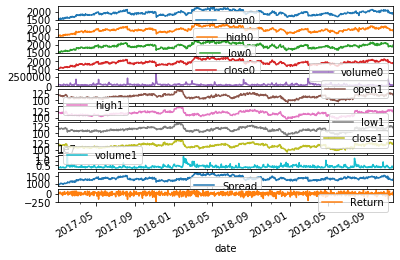

In [19]:
features.plot(subplots=True)

### Training-test split and scaling

In [20]:
features.dropna(inplace=True)
dataset = features.values
train_ratio = 0.8
n_set = len(dataset) + 1 
n_train = int(np.round(n_set * train_ratio))
n_test = n_set - n_train

from sklearn import preprocessing
x = dataset #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(dataset)
dataset = pd.DataFrame(x_scaled).to_numpy()

### Dataset helper function

In [21]:
def multivariate_data(dataset, target, start_index, end_index, history_size,
                     target_size, step, single_step=False):
    data = []
    labels = []
    
    start_index += history_size
    if not end_index:
        end_index = len(dataset) - target_size
        
    for i in range(start_index, end_index):
        indices = range(i - history_size, i, step)
        
        data.append(dataset[indices])
        
        if single_step:
            labels.append(target[i+target_size])
        else:
            labels.append(target[i:i+target_size])
            
    return np.array(data), np.array(labels)

In [22]:
past_history = 63 # 1 month
future_target = 14 # 3 days into the future
STEP = 1 # stepping 1 day at a time

x_train_single, y_train_single = multivariate_data(dataset[:, :-1], dataset[:, -2], 0,
                                                   n_train, past_history,
                                                   future_target, STEP,
                                                   single_step=True)
x_val_single, y_val_single = multivariate_data(dataset[:, :-1], dataset[:, -2],
                                               n_train, None, past_history,
                                               future_target, STEP,
                                               single_step=True)



### Batch generator

In [23]:
BATCH_SIZE = 256
BUFFER_SIZE = 10000
train_data_single = tf.data.Dataset.from_tensor_slices((x_train_single, y_train_single))
train_data_single = train_data_single.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()

val_data_single = tf.data.Dataset.from_tensor_slices((x_val_single, y_val_single))
x_train_single, y_train_single = multivariate_data(dataset[:, :-1], dataset[:, -2], 0,
                                                   n_train, past_history,
                                                   future_target, STEP,
                                                   single_step=True)
x_val_single, y_val_single = multivariate_data(dataset[:, :-1], dataset[:, -2],
                                               n_train, None, past_history,
                                               future_target, STEP,
                                               single_step=True)
val_data_single = val_data_single.batch(BATCH_SIZE).repeat()

### Single Step Model (LSTM)

In [24]:
single_step_model = tf.keras.models.Sequential()
single_step_model.add(tf.keras.layers.LSTM(past_history,
                                           input_shape=x_train_single.shape[-2:]))

single_step_model.add(tf.keras.layers.Dense(1,
                     activation=tf.nn.relu))

sgd = tf.keras.optimizers.SGD(lr=0.01, clipvalue=0.5)
single_step_model.compile(optimizer=sgd, loss='mse')

In [25]:
for x, y in val_data_single.take(1):
  print(single_step_model.predict(x).shape)

(68, 1)


In [26]:
import matplotlib.pyplot as plt
%matplotlib inline
EVALUATION_INTERVAL = 200
EPOCHS = 10
single_step_history = single_step_model.fit(train_data_single, epochs=EPOCHS,
                                            steps_per_epoch=EVALUATION_INTERVAL,
                                            validation_data=val_data_single,
                                            validation_steps=50)

Train for 200 steps, validate for 50 steps
Epoch 1/10
200/200 [==============================] - 4s 20ms/step - loss: 0.0299 - val_loss: 0.0110
Epoch 2/10
200/200 [==============================] - 3s 15ms/step - loss: 0.0164 - val_loss: 0.0117
Epoch 3/10
200/200 [==============================] - 3s 16ms/step - loss: 0.0147 - val_loss: 0.0125
Epoch 4/10
200/200 [==============================] - 3s 16ms/step - loss: 0.0144 - val_loss: 0.0122
Epoch 5/10
200/200 [==============================] - 3s 16ms/step - loss: 0.0145 - val_loss: 0.0124
Epoch 6/10
200/200 [==============================] - 3s 16ms/step - loss: 0.0142 - val_loss: 0.0124
Epoch 7/10
200/200 [==============================] - 3s 16ms/step - loss: 0.0141 - val_loss: 0.0123
Epoch 8/10
200/200 [==============================] - 3s 16ms/step - loss: 0.0135 - val_loss: 0.0125
Epoch 9/10
200/200 [==============================] - 3s 16ms/step - loss: 0.0137 - val_loss: 0.0126
Epoch 10/10
200/200 [===========================

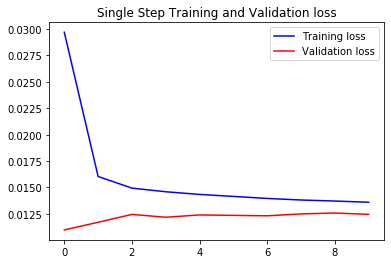

In [27]:
def plot_train_history(history, title):
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  epochs = range(len(loss))

  plt.figure()

  plt.plot(epochs, loss, 'b', label='Training loss')
  plt.plot(epochs, val_loss, 'r', label='Validation loss')
  plt.title(title)
  plt.legend()

  plt.show()

plot_train_history(single_step_history,
                   'Single Step Training and Validation loss')

### Single Step Prediction

In [28]:
def create_time_steps(length):
  time_steps = []
  for i in range(-length, 0, 1):
    time_steps.append(i)
  return time_steps

In [29]:
def show_plot(plot_data, delta, title):
  labels = ['History', 'True Future', 'Model Prediction']
  marker = ['.-', 'rx', 'go']
  time_steps = create_time_steps(plot_data[0].shape[0])
  if delta:
    future = delta
  else:
    future = 0

  plt.title(title)
  for i, x in enumerate(plot_data):
    if i:
      plt.plot(future, plot_data[i], marker[i], markersize=10,
               label=labels[i])
    else:
      plt.plot(time_steps, plot_data[i].flatten(), marker[i], label=labels[i])
  plt.legend()
  plt.xlim([time_steps[0], (future+5)*2])
  plt.xlabel('Time-Step')
  return plt

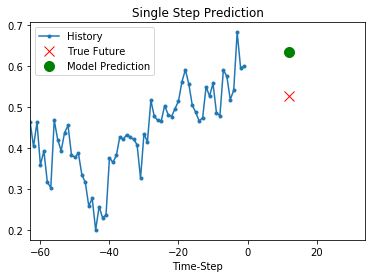

In [30]:
for x, y in val_data_single.take(1):
  plot = show_plot([x[0][:, 1].numpy(), y[0].numpy(),
                    single_step_model.predict(x)[0]], 12,
                   'Single Step Prediction')
  plot.show()

### Multistep Model

In [31]:
x_train_multi, y_train_multi = multivariate_data(dataset[:, :-1], dataset[:, -2], 0,
                                                 n_train, past_history,
                                                 future_target, STEP)
x_val_multi, y_val_multi = multivariate_data(dataset[:, :-1], dataset[:, -2],
                                             n_train, None, past_history,
                                             future_target, STEP)



In [32]:
print ('Single window of past history : {}'.format(x_train_multi[0].shape))
print ('\n Target spread to predict : {}'.format(y_train_multi[0].shape))

Single window of past history : (63, 11)

 Target spread to predict : (14,)


In [33]:
train_data_multi = tf.data.Dataset.from_tensor_slices((x_train_multi, y_train_multi))
train_data_multi = train_data_multi.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()

val_data_multi = tf.data.Dataset.from_tensor_slices((x_val_multi, y_val_multi))
val_data_multi = val_data_multi.batch(BATCH_SIZE).repeat()

In [34]:
def multi_step_plot(history, true_future, prediction):
    plt.figure(figsize=(12, 6))
    num_in = create_time_steps(len(history))
    num_out = len(true_future)
    history_to_plot = np.array(history[:, 1])
    plt.plot(num_in, history_to_plot, label='History')
    true_future_to_plot = np.array(true_future)
    plt.plot(np.arange(num_out)/STEP, true_future_to_plot, 'bo',
           label='True Future')
    ymin = np.min([np.min(history_to_plot),np.min(true_future_to_plot)])
    ymax = np.max([np.max(history_to_plot),np.max(true_future_to_plot)])

    if prediction.any():
        plt.plot(np.arange(num_out)/STEP, np.array(prediction), 'ro',
             label='Predicted Future')
    plt.legend(loc='upper left')
    plt.ylim(.8*ymin, 1.2*ymax)
    plt.show()

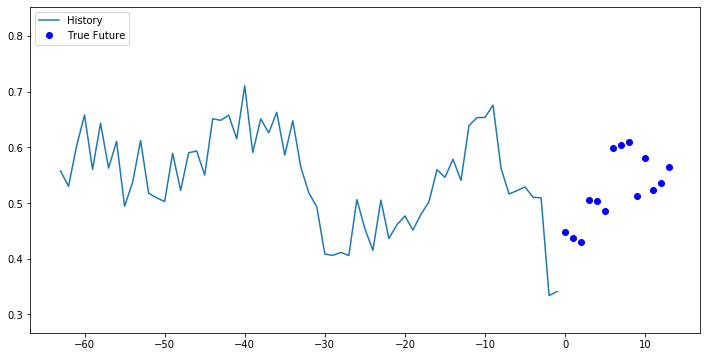

In [35]:
for x, y in train_data_multi.take(1):
  multi_step_plot(x[0], y[0], np.array([0]))

In [36]:
multi_step_model = tf.keras.models.Sequential()
multi_step_model.add(tf.keras.layers.LSTM(64,
                                          return_sequences=True,
                                          input_shape=x_train_multi.shape[-2:]))
multi_step_model.add(tf.keras.layers.LSTM(32, activation=tf.nn.relu))
multi_step_model.add(tf.keras.layers.Dense(future_target, activation=tf.nn.relu))
sgd = tf.keras.optimizers.SGD(lr=0.01, clipvalue=0.5)
multi_step_model.compile(optimizer=sgd, loss='mse')

In [37]:
for x, y in val_data_multi.take(1):
  print (multi_step_model.predict(x).shape)

(68, 14)


In [38]:
multi_step_history = multi_step_model.fit(train_data_multi, epochs=EPOCHS,
                                          steps_per_epoch=EVALUATION_INTERVAL,
                                          validation_data=val_data_multi,
                                          validation_steps=20)

Train for 200 steps, validate for 20 steps
Epoch 1/10
200/200 [==============================] - 15s 76ms/step - loss: 0.1656 - val_loss: 0.1443
Epoch 2/10
200/200 [==============================] - 18s 91ms/step - loss: 0.1105 - val_loss: 0.0885
Epoch 3/10
200/200 [==============================] - 18s 88ms/step - loss: 0.0871 - val_loss: 0.0880
Epoch 4/10
200/200 [==============================] - 16s 78ms/step - loss: 0.0860 - val_loss: 0.0881
Epoch 5/10
200/200 [==============================] - 13s 67ms/step - loss: 0.0842 - val_loss: 0.0882
Epoch 6/10
200/200 [==============================] - 17s 86ms/step - loss: 0.0842 - val_loss: 0.0883
Epoch 7/10
200/200 [==============================] - 17s 86ms/step - loss: 0.0827 - val_loss: 0.0887
Epoch 8/10
200/200 [==============================] - 17s 87ms/step - loss: 0.0855 - val_loss: 0.0886
Epoch 9/10
200/200 [==============================] - 16s 78ms/step - loss: 0.0839 - val_loss: 0.0885
Epoch 10/10
200/200 [==================

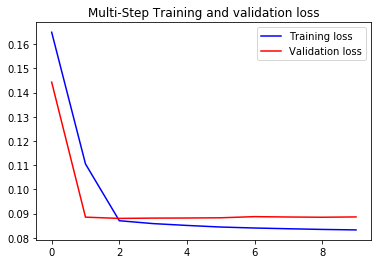

In [39]:
plot_train_history(multi_step_history, 'Multi-Step Training and validation loss')

### Multistep Prediction

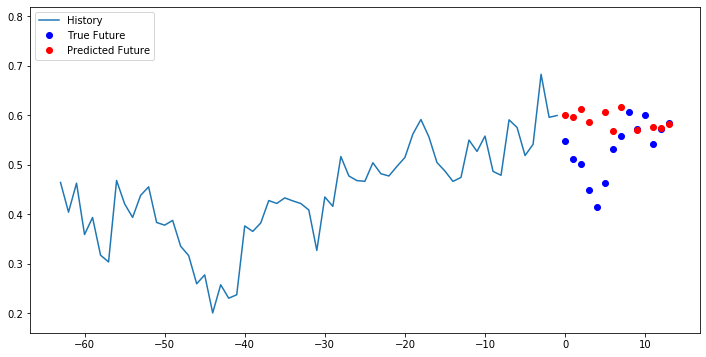

In [40]:
for x, y in val_data_multi.take(1):
  multi_step_plot(x[0], y[0], multi_step_model.predict(x)[0])

## Pre-optimised Trading Criteria

### Open position

We introduce two upper thresholds and two lower thresholds for the spread. The first pair of upper and lower thresholds indicates one rolling standard deviation (conditional volatility value) from the rolling mean. The second pair consists of the window provided by two conditional volatility deviations from the mean. The first and second pair of thresholds shall be referred to as the minor and major thresholds respectively. The idea here is to capitalise on the volaility of the spread. If it moves from within the minor band to the minor-major band, a decision is made whether to take a long-short position based on the NN prediction on the spread. If the spread spikes from within the minor band to outside the major threshold and the NN prediction indicates that the spread will undergo mean-reversion within the next 3 days, then a long-short position is taken.

In summary, the two types of positions that might be opened by this model.

1. The spread crosses the minor threshold but not the major threshold. The NN prediction is checked to see if the spread is predicted to continue moving up or move back down.     
    1. Wait: the NN predicts that further deviation from the mean will occur. Open if the next timestep agrees with the NN prediction.
    2. Open: the NN predicts that mean reversion will occur.
        
2. Open: the spread crosses the major threshold in one timestep and the NN prediction predicts reversion in the next 3 days.
    
### Close position

1. From Type 1A: the spread reaches its dynamic mean.
2. From Types 1B and 2: the spread reverts back within the minor threshold. 
3. Types 1B and 2 indicate further mean divergence after 1 day that is contrary to its initial NN prediction.
4. The position has been open for more than 5 days.

The next component of this article will demonstrate backtesting this full algorithm on Quantopian.

<div class="cite2c-biblio"></div>

## References 

1. Figuerola-Ferretti, Isabel, Pedro Serrano, Tao Tang, and Antoni Vaello-Sebastià. 2017. Supercointegrated. SSRN Scholarly Paper ID 3005358. Rochester, NY: Social Science Research Network. https://papers.ssrn.com/abstract=3005358.
2. Józefowicz, Rafal, Wojciech Zaremba, and Ilya Sutskever. 2015. “An Empirical Exploration of Recurrent Network Architectures.” In ICML.